# Required packages

In [1]:
# Install extra packages (For Google Colab)
!pip install optuna
!pip install lightgbm

Looking in indexes: https://mirrors.ustc.edu.cn/pypi/web/simple


Looking in indexes: https://mirrors.ustc.edu.cn/pypi/web/simple


In [2]:
# Ordinary packages
import datetime
import threading
import os
import itertools

# Standard packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

# Preprocess
from sklearn import preprocessing
from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures
from category_encoders.cat_boost import CatBoostEncoder

# Model Selection
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_validate

# Metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score
from sklearn.metrics import auc
from sklearn.metrics import roc_curve
from sklearn.metrics import precision_score
from sklearn.metrics import average_precision_score
from sklearn.metrics import log_loss

# Classifier
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegressionCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.tree import DecisionTreeClassifier
from sklearn import svm
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier

# Optimization
import optuna
from optuna.samplers import TPESampler


# Google Colab Packages (delete when local)
try:
    from google.colab import drive
    RUN_MODE = 'GOOGLE'
except:
    RUN_MODE = 'LOCAL'

warnings.filterwarnings('ignore')

In [3]:
# Plot preset
%matplotlib inline
sns.set_context('notebook')
sns.set_style('darkgrid')
sns.set_palette('Accent') # set custom color scheme
plt.rcParams['figure.figsize'] = (9, 6)

# Data Import

In [4]:
if RUN_MODE == 'GOOGLE':
    drive.mount('/content/drive')
    os.chdir("/content/drive/My Drive/Colab Notebooks/Group 169")
else:
    pass

In [5]:
train_raw = pd.read_csv('Data/bank_train.csv')
test_raw = pd.read_csv('Data/bank_test.csv')

In [6]:
print(train_raw.shape)
train_raw.info()

(29387, 16)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29387 entries, 0 to 29386
Data columns (total 16 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   age         29387 non-null  int64 
 1   job         29387 non-null  object
 2   marital     29387 non-null  object
 3   education   29387 non-null  object
 4   default     29387 non-null  object
 5   balance     29387 non-null  int64 
 6   housing     29387 non-null  object
 7   loan        29387 non-null  object
 8   contact     29387 non-null  object
 9   day         29387 non-null  int64 
 10  month       29387 non-null  object
 11  campaign    29387 non-null  int64 
 12  pdays       29387 non-null  int64 
 13  previous    29387 non-null  int64 
 14  poutcome    29387 non-null  object
 15  subscribed  29387 non-null  object
dtypes: int64(6), object(10)
memory usage: 3.6+ MB


In [7]:
train_raw.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,campaign,pdays,previous,poutcome,subscribed
0,29,admin.,married,secondary,no,1489,yes,no,cellular,20,apr,1,-1,0,unknown,no
1,33,admin.,single,tertiary,no,3379,no,no,cellular,20,nov,3,-1,0,unknown,no
2,30,management,married,tertiary,no,3134,yes,no,cellular,17,jul,1,-1,0,unknown,no
3,33,admin.,divorced,secondary,no,294,yes,no,cellular,8,may,1,-1,0,unknown,yes
4,42,technician,married,tertiary,no,644,yes,no,unknown,7,may,1,-1,0,unknown,no


In [8]:
train_raw.isnull().sum()

age           0
job           0
marital       0
education     0
default       0
balance       0
housing       0
loan          0
contact       0
day           0
month         0
campaign      0
pdays         0
previous      0
poutcome      0
subscribed    0
dtype: int64

## Data Dictionary
| Name | Description | Type |
| --- | --- | --- |
| <u>id</u> | Unique customer id | int |
| age | Customer's age | int |
| job | Type of job | string |
| marital | Marital status | string |
| education | Level of education | string |
| default | Has credit in default | string |
| balance | Average yearly balance | int |
| housing | Has a housing loan | string |
| loan | Has a personal loan | string |
| contact | Contact communication type | string |
| day | Day of contact | int |
| month | Month of contact | string |
| campaign | Number of contacts during this campaign & this client | int |
| pdays | Number of days from a previous campaign (-1 = haven't contacted) | int |
| previous | Number of contacts performed before this campaign & for this client | int |
| poutcome | Outcome of the previous marketing campaign | string |
| <font color='pink'>subscribed</font> | Did the client subscribe to a term deposit | int |

# Data Transform & EDA

## Target Variable

In [9]:
train_raw.groupby('subscribed').size()

subscribed
no     25949
yes     3438
dtype: int64

In [10]:
train = train_raw.copy()
train['subscribed'] = train_raw['subscribed'].apply(lambda x : 0 if x == 'no' else 1)
train['pdays'] = train['pdays'].replace({-1: 999})
train.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,campaign,pdays,previous,poutcome,subscribed
0,29,admin.,married,secondary,no,1489,yes,no,cellular,20,apr,1,999,0,unknown,0
1,33,admin.,single,tertiary,no,3379,no,no,cellular,20,nov,3,999,0,unknown,0
2,30,management,married,tertiary,no,3134,yes,no,cellular,17,jul,1,999,0,unknown,0
3,33,admin.,divorced,secondary,no,294,yes,no,cellular,8,may,1,999,0,unknown,1
4,42,technician,married,tertiary,no,644,yes,no,unknown,7,may,1,999,0,unknown,0


## Numerical Variables

In [11]:
def pct(category, value):
    temp = train[train[category] == value]['subscribed']
    temp_ys = sum(temp) # Yes
    temp_ns = len(temp) - temp_ys # No
    temp_r = temp_ys / len(temp) # Rate of Yes
    temp_array = np.array((temp_ys, temp_ns, temp_r))
    return(temp_array)

def normalization(arr):
    arr_min = arr.min()
    arr_max = arr.max()
    for i in range(len(arr)):
        arr[i] = (arr[i] - arr_min) / (arr_max - arr_min)
    return arr

def catExplore(category, use_pct = False):
    cat_col = train[category].sort_values().unique()
    data_info = pd.DataFrame(columns = ['category', 'value', 'yes', 'no', 'pct'])
    for value in cat_col:
        temp = [category, value]
        temp_array = pct(category, value)
        temp.append(temp_array[0])
        temp.append(temp_array[1])
        temp.append(temp_array[2])
        temp = pd.Series(temp, index=['category', 'value', 'yes', 'no', 'pct'])
        data_info = data_info.append(temp, ignore_index = True)
      
    fig, axes = plt.subplots(1, 3, figsize=(25, 5))
    # Box Plot
    ax = fig.axes[0]         
    sns.boxplot(train[category], ax=ax)
    ax.set_title('Box')
    ax.set_xlabel('')
    ax.set_ylabel('')

    # Reg Plot
    ax = fig.axes[1]         
    sns.regplot(train[category], train['subscribed'], ci=None, logistic=True, y_jitter=0.05, scatter_kws={'s': 25, 'alpha':.5}, ax=ax)
    ax.set_title('Reg')
    ax.set_xlabel('')
    ax.set_ylabel('')

    # Bar + PCT
    ax = fig.axes[2] 
    if use_pct:
        data_col = data_info['value'].unique().astype(int)
        data_info['total'] = data_info['yes'] + data_info['no']
        data_info['total_scaled'] = normalization(data_info['total'])
        data_info['yes_scaled'] = data_info['total_scaled'] * data_info['pct']
        data_info['no_scaled'] = data_info['total_scaled'] - data_info['yes_scaled']
        ax.bar(range(data_col[0], len(data_col) + data_col[0]), height = data_info['no_scaled'], label = 'no')
        ax.bar(range(data_col[0], len(data_col) + data_col[0]), height = data_info['yes_scaled'], bottom = data_info['no_scaled'], label = 'yes')
        sns.lineplot(data_info['value'], data_info['pct'], color = 'green', label = 'positive rate')
        ax.set_title('Bar + PCT')
        ax.set_xlabel('')
        ax.set_ylabel('')
    else:
        fig.delaxes(ax)

    plt.show()

def monthFormat(x):
    month_dict = {'apr':4, 'nov':11, 'jul':7, 'may':5, 'jun':6, 'aug':8, 'feb':2, 'jan':1, 'sep':9,
       'oct':10, 'mar':3, 'dec':12}
    if x in month_dict.keys():
        return month_dict[x]
    return x

def dateFormat(arr):
    date_temp = datetime.datetime(2021, arr['month'], arr['day'])
    return date_temp    

def getOutlier(cat):
    # IQR = Q3 - Q1
    # LB: Q1 - 1.5 * IQR 
    # UB: Q3 + 1.5 * IQR
    Q1 = train[cat].quantile(q = 0.25)
    Q3 = train[cat].quantile(q = 0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outlier = train[(train[cat] < lower_bound) | (train[cat] > upper_bound)][cat]
    print("{} outlier: {:.2f}%".format(cat, outlier.count() / train[cat].count() * 100))
    
def removeOutlier(cat):
    Q1 = train[cat].quantile(q = 0.25)
    Q3 = train[cat].quantile(q = 0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outlier = train[(train[cat] < lower_bound) | (train[cat] > upper_bound)][cat]
    print("{} outliers are removed.".format(outlier.count()))
    return train[(train[cat] >= lower_bound) & (train[cat] <= upper_bound)]

In [12]:
train['month'] = train['month'].apply(monthFormat)
train['date'] = train.apply(dateFormat, axis=1)
start_date = train.sort_values('date').iloc[0, :]['date']
train['date_diff'] = train['date'] - start_date
train['date_diff'] = train['date_diff'].astype('str').apply(lambda x:x[:-5]).astype('int32')
train.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,campaign,pdays,previous,poutcome,subscribed,date,date_diff
0,29,admin.,married,secondary,no,1489,yes,no,cellular,20,4,1,999,0,unknown,0,2021-04-20,104
1,33,admin.,single,tertiary,no,3379,no,no,cellular,20,11,3,999,0,unknown,0,2021-11-20,318
2,30,management,married,tertiary,no,3134,yes,no,cellular,17,7,1,999,0,unknown,0,2021-07-17,192
3,33,admin.,divorced,secondary,no,294,yes,no,cellular,8,5,1,999,0,unknown,1,2021-05-08,122
4,42,technician,married,tertiary,no,644,yes,no,unknown,7,5,1,999,0,unknown,0,2021-05-07,121


  0%|                                                                                          | 0/542 [00:00<…


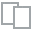
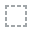
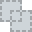
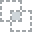
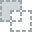
...
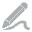
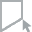
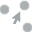
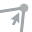
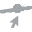

In [13]:
from dataprep.eda import plot
num_var = ['age', 'balance', 'campaign', 'pdays', 'previous', 'day', 'month', 'date_diff']
plot(train[num_var])

### Age

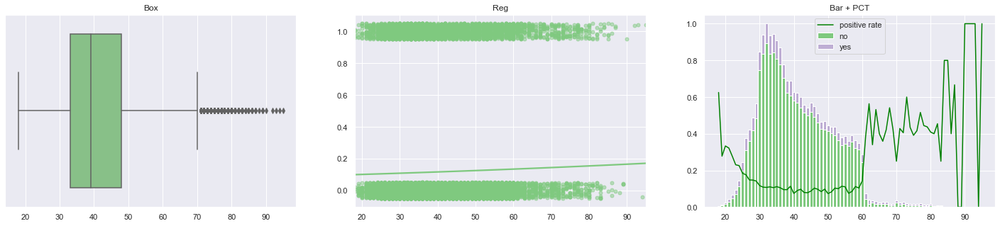

In [14]:
category = 'age'
catExplore(category, use_pct = True)

In [15]:
getOutlier(category)

age outlier: 1.09%


  0%|                                                                                          | 0/107 [00:00<…


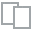
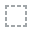
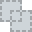
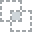
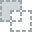
...
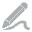
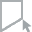
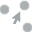
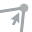
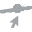

In [16]:
yj = PowerTransformer(method='yeo-johnson')
train_temp = train.copy()
train_temp['age']  = yj.fit_transform(train[['age']])
plot(train_temp, 'age')

### Balance

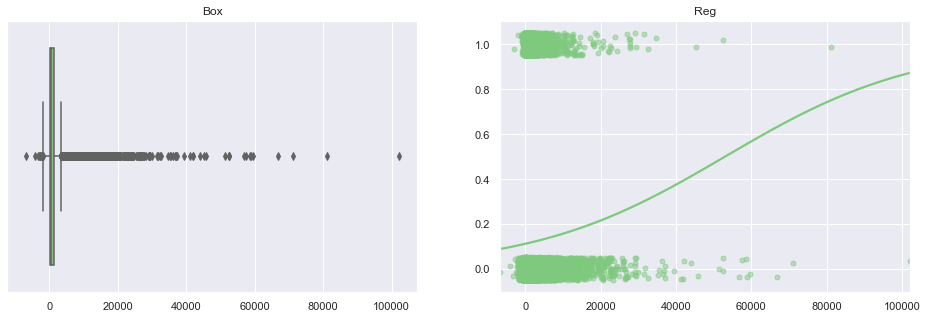

In [17]:
category = 'balance'
catExplore(category)

In [18]:
getOutlier(category)

balance outlier: 10.51%


In [19]:
# train = removeOutlier(category)
# train = train[train['balance'] < 80000]

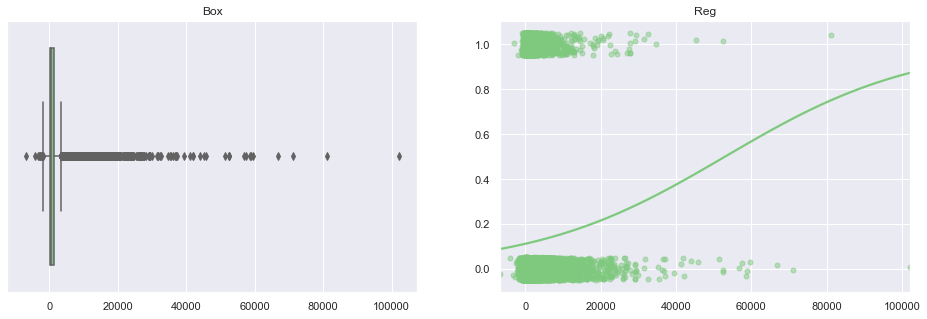

In [20]:
catExplore(category)

  0%|                                                                                          | 0/107 [00:00<…


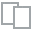
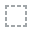
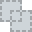
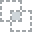
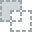
...
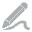
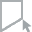
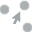
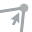
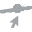

In [21]:
yj = PowerTransformer(method='yeo-johnson')
train_temp = train.copy()
train_temp['balance']  = yj.fit_transform(train[['balance']])
plot(train_temp, 'balance')

### Campaign

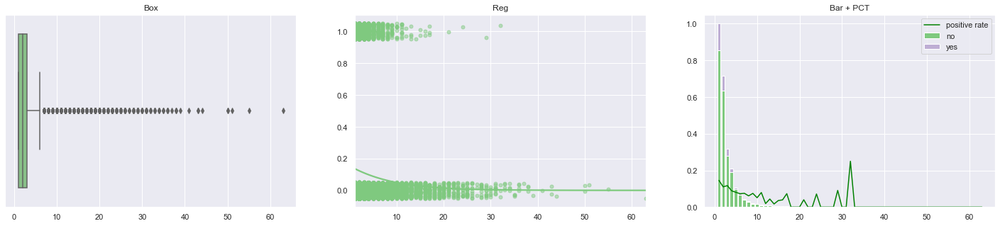

In [22]:
category = 'campaign'
catExplore(category, use_pct = True)

In [23]:
getOutlier(category)

campaign outlier: 6.91%


  0%|                                                                                          | 0/107 [00:00<…


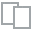
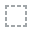
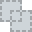
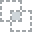
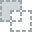
...
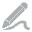
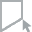
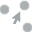
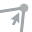
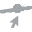

In [24]:
yj = PowerTransformer(method='yeo-johnson')
train_temp = train.copy()
train_temp['campaign']  = yj.fit_transform(train[['campaign']])
plot(train_temp, 'campaign')

### Pdays

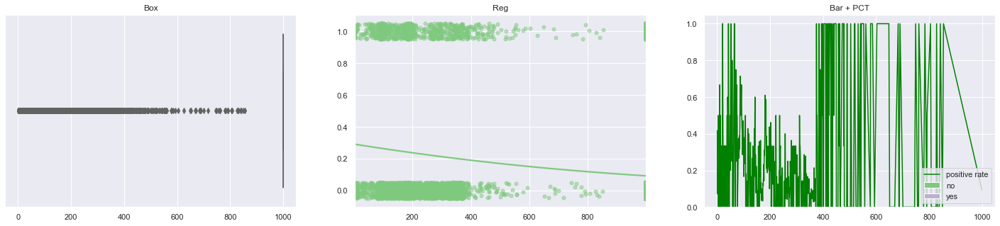

In [25]:
category = 'pdays'
catExplore(category, use_pct = True)

In [26]:
getOutlier(category)

pdays outlier: 18.21%


### Previous

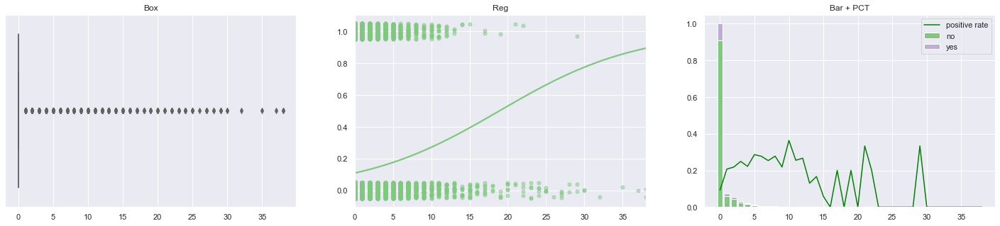

In [27]:
category = 'previous'
catExplore(category, use_pct = True)

In [28]:
getOutlier(category)

previous outlier: 18.21%


### Date

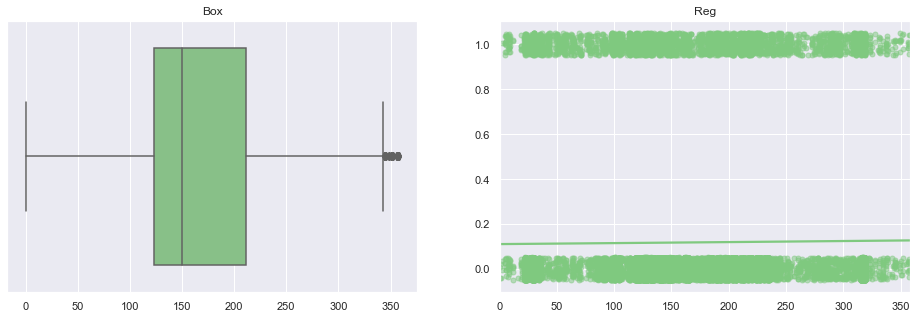

In [29]:
category = 'date_diff'
catExplore(category)

  0%|                                                                                          | 0/107 [00:00<…


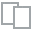
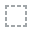
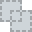
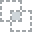
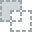
...
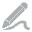
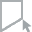
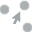
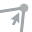
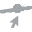

In [30]:
yj = PowerTransformer(method='yeo-johnson')
train_temp = train.copy()
train_temp['date_diff']  = yj.fit_transform(train[['date_diff']])
plot(train_temp, 'date_diff')

In [31]:
date_y_cross = pd.crosstab(train['subscribed'], train['month'])
date_y_cross_rate =  date_y_cross.apply(lambda x : x/x.sum() * 100).transpose().reset_index(drop=True)
date_y_cross_rate

subscribed,0,1
0,89.142237,10.857763
1,82.830626,17.169374
2,48.902821,51.097179
3,80.732984,19.267016
4,93.135935,6.864065
5,90.095569,9.904431
6,90.917069,9.082931
7,88.727898,11.272102
8,53.804348,46.195652
9,55.627706,44.372294


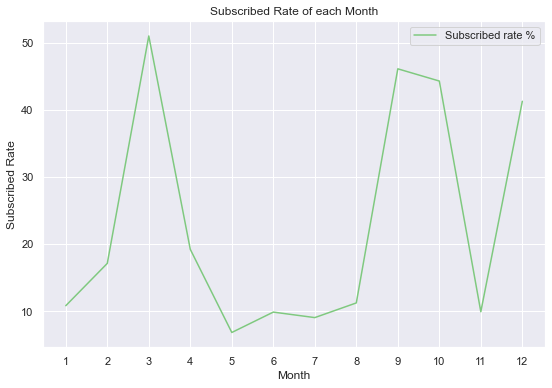

In [32]:
plt.plot(date_y_cross_rate.index, date_y_cross_rate[1], label='Subscribed rate %')
plt.xticks(date_y_cross_rate.index, date_y_cross_rate.index + 1)
plt.xlabel('Month')
plt.ylabel('Subscribed Rate')
plt.title('Subscribed Rate of each Month')
plt.legend()
plt.show()

### -- Short Summary

In [33]:
num_list = ['age', 'balance', 'month', 'day', 'pdays', 'previous', 'campaign'] # delete campaign, date_diff, pdays, days
num_count = len(num_list)
rows = int(np.ceil(num_count/3))

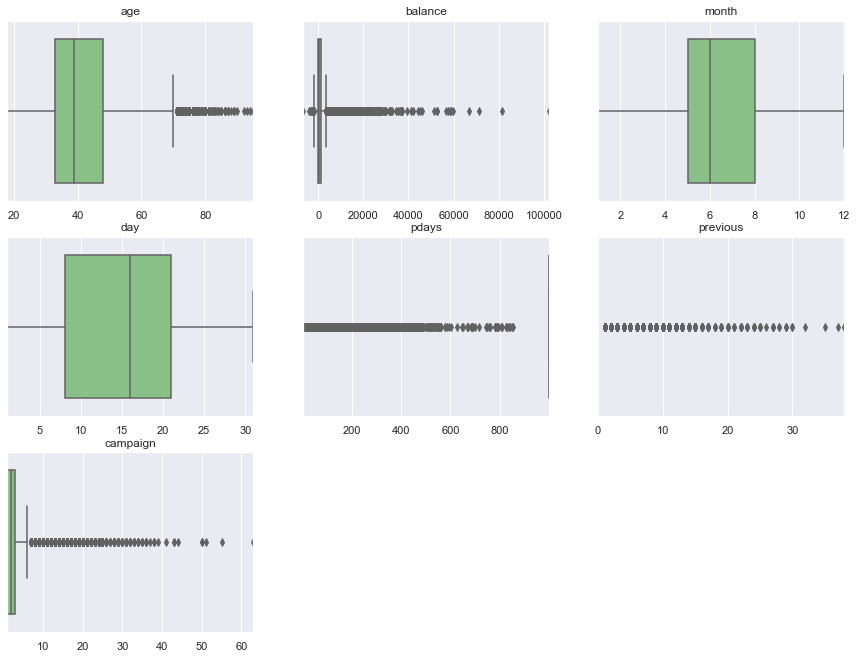

In [34]:
fig, axes = plt.subplots(rows, 3, figsize=(15, rows*(15/4)))
for i, ax in enumerate(fig.axes):
    if i < num_count:
        sns.boxplot(train[num_list[i]], ax=ax)
        ax.set_title(num_list[i])
        ax.set_xlabel('')
        ax.set_ylabel('')
        ax.set_xlim(train[num_list[i]].min(),train[num_list[i]].max())
    else:
        fig.delaxes(ax)
plt.show()

In [35]:
num_scaled = preprocessing.scale(train[num_list])

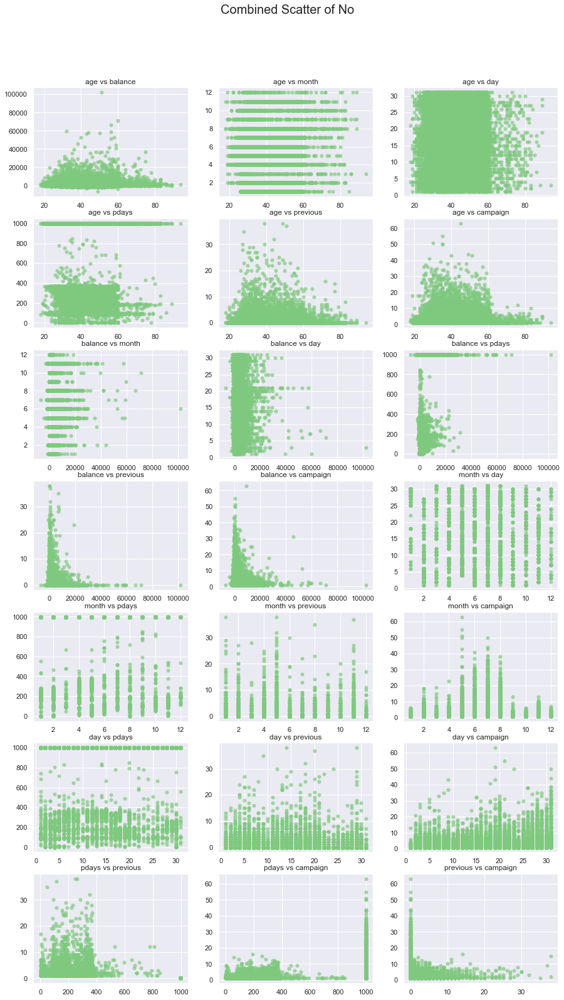

In [36]:
iter_comb = itertools.combinations(num_list, 2)
iter_list = []
for item in iter_comb:
    iter_list.append(item)

count = len(iter_list)
rows = int(np.ceil(count / 3))
fig, axes = plt.subplots(rows, 3, figsize=(15, rows*(15/4)))
sns.set_palette('Accent_r')
for i, ax in enumerate(fig.axes):
    if i < count:
        sns.scatterplot(x=iter_list[i][0], y=iter_list[i][1], data=train[train['subscribed'] == 0], ax=ax, alpha=0.7, linewidth=0)
        ax.set_title(iter_list[i][0] + ' vs ' + iter_list[i][1])
        ax.set_xlabel('')
        ax.set_ylabel('')
    else:
        fig.delaxes(ax)
plt.suptitle("Combined Scatter of No", fontsize=20, y=0.95)
plt.show()

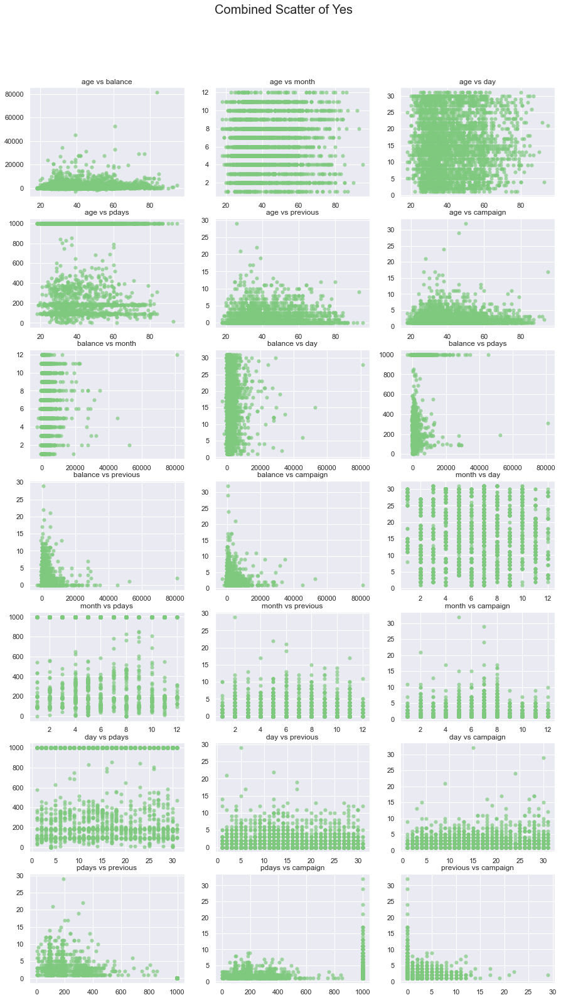

In [37]:
iter_comb = itertools.combinations(num_list, 2)
iter_list = []
for item in iter_comb:
    iter_list.append(item)

count = len(iter_list)
rows = int(np.ceil(count / 3))
sns.set_palette('Accent')
fig, axes = plt.subplots(rows, 3, figsize=(15, rows*(15/4)))
for i, ax in enumerate(fig.axes):
    if i < count:
        sns.scatterplot(x=iter_list[i][0], y=iter_list[i][1], data=train[train['subscribed'] == 1], ax=ax, alpha=0.7, linewidth=0)
        ax.set_title(iter_list[i][0] + ' vs ' + iter_list[i][1])
        ax.set_xlabel('')
        ax.set_ylabel('')
    else:
        fig.delaxes(ax)
plt.suptitle("Combined Scatter of Yes", fontsize=20, y=0.95)
plt.show()

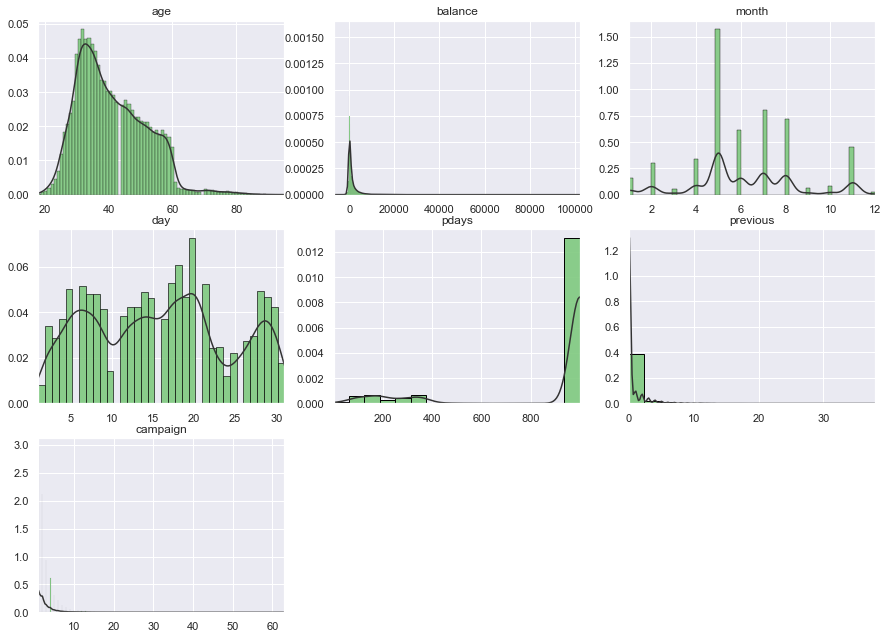

In [38]:
fig, axes = plt.subplots(rows, 3, figsize=(15, rows*(15/4)))
for i, ax in enumerate(fig.axes):
    if i < num_count:
        sns.histplot(train[num_list[i]], ax=ax, stat='density', kde=False, alpha=0.9, edgecolor='black')
        sns.kdeplot(train[num_list[i]], ax=ax, alpha=0.6, color='#333333')
        ax.set_title(num_list[i])
        ax.set_xlabel('')
        ax.set_ylabel('')
        ax.set_xlim(train[num_list[i]].min(),train[num_list[i]].max())
    else:
        fig.delaxes(ax)
plt.show()

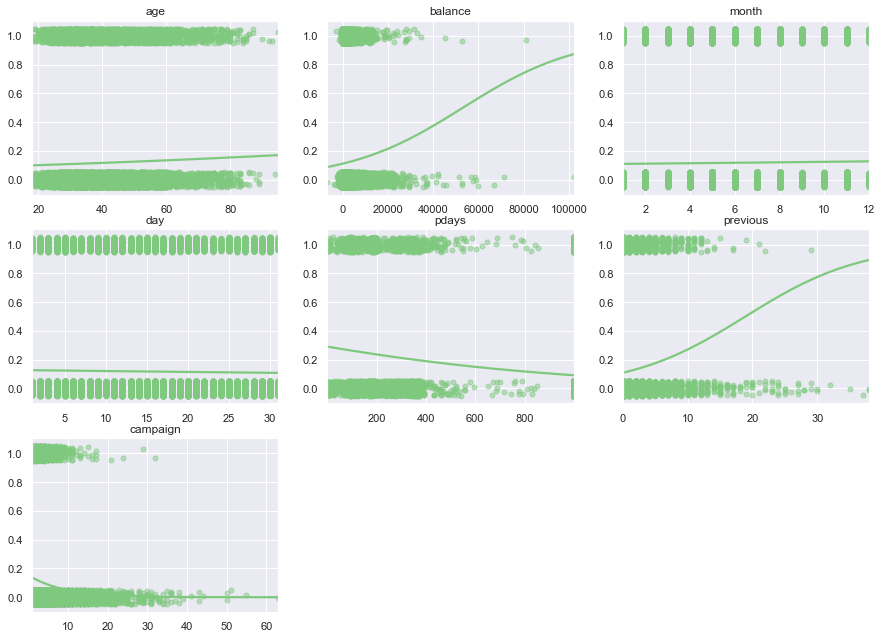

In [39]:
fig, axes = plt.subplots(rows, 3, figsize=(15, rows*(15/4)))
for i, ax in enumerate(fig.axes):
    if i < num_count:          
        sns.regplot(train[num_list[i]], train['subscribed'], ci=None, logistic=True, y_jitter=0.05, scatter_kws={'s': 25, 'alpha':.5}, ax=ax)
        ax.set_title(num_list[i])
        ax.set_xlabel('')
        ax.set_ylabel('')
        ax.set_xlim(train[num_list[i]].min(),train[num_list[i]].max())
    else:
        fig.delaxes(ax)

plt.show()

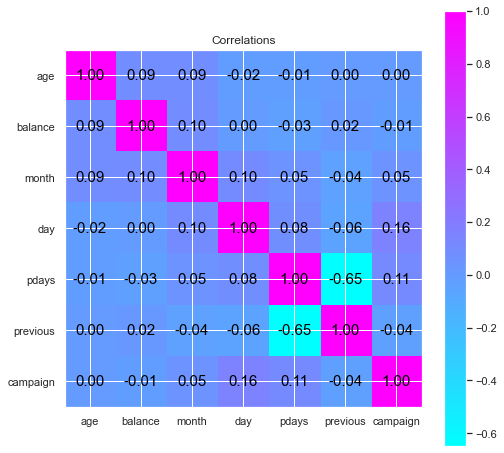

In [40]:
# Get the correlations
corr = train[num_list].corr()
n_var = len(corr)
plt.figure(figsize=(8, 8))
# Plot the heatmap
plt.imshow(corr, cmap = 'cool')
plt.xticks(range(n_var), corr.columns)
plt.yticks(range(n_var), corr.columns)

for i in range(n_var):
    for j in range(n_var):
        plt.text(i, j, '{:.2f}'.format(corr.iloc[i, j]), ha="center", va="center", color="k", fontsize = 15)

plt.colorbar()
plt.title('Correlations')
plt.show()

## Catergorical Variables

In [41]:
cat_var = ['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'poutcome']
cat_count = []
for column in cat_var:
    cat_count.append({'column':column, 'cat_count':len(train[column].unique())})
    
pd.DataFrame(cat_count)

,column,cat_count
0,job,12
1,marital,3
2,education,4
3,default,2
4,housing,2
5,loan,2
6,contact,3
7,poutcome,4


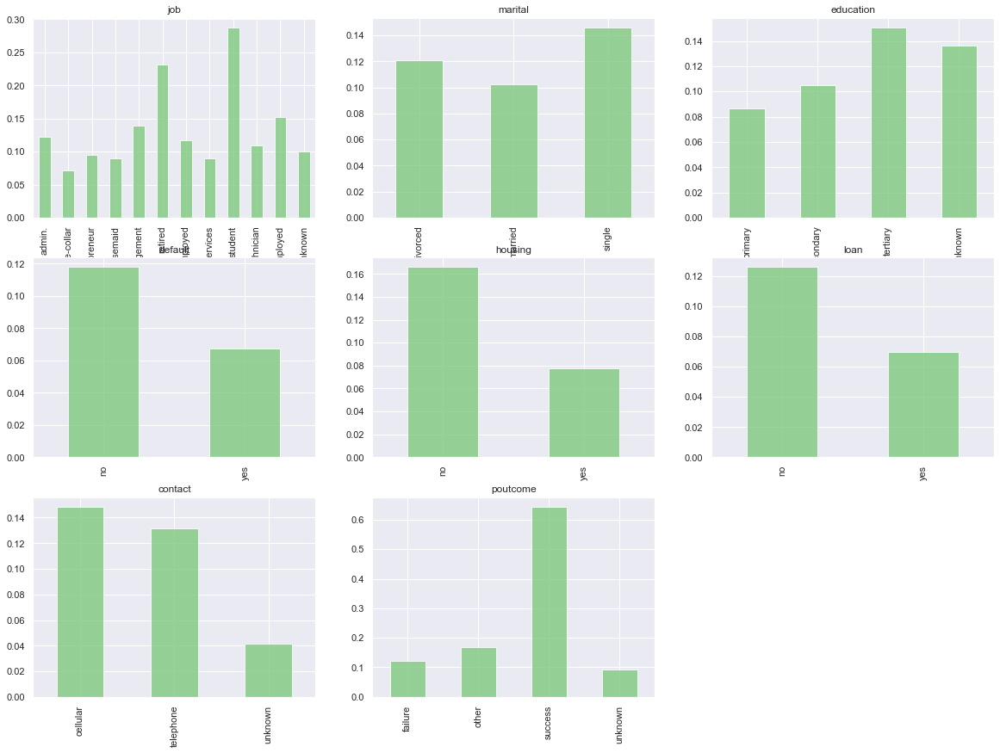

In [42]:
fig, axes = plt.subplots(rows, 3, figsize=(20, rows*(20/4)))
for i, ax in enumerate(fig.axes):
    if i < len(cat_var):
        table = pd.crosstab(train['subscribed'], train[cat_var[i]])
        table = (table/table.sum()).iloc[1,:]
        (table.T).sort_index().plot(kind='bar', alpha=0.8, ax=ax)

        ax.set_title(cat_var[i])
        ax.set_ylabel('')
        ax.set_xlabel('')
    else:
        fig.delaxes(ax)

In [43]:
def plotYesNo(cat, text=False):
    cat_y_cross = pd.crosstab(train['subscribed'], train[cat])
    cat_y_cross_rate = cat_y_cross.apply(lambda x : x / x.sum() * 100).reset_index(drop=True)
    plt.bar(cat_y_cross_rate.columns, cat_y_cross_rate.iloc[1, :], width=0.4)
    plt.xticks(rotation = -45)
    plt.xlabel(cat)
    plt.ylabel('Subscribed Rate')
    plt.title('Subscribed Rate of each ' + cat)
    plt.show()

### Job

In [44]:
category = 'job'
job = train[category].sort_values().unique()
data_info = pd.DataFrame(columns = ['category', 'value', 'yes', 'no', 'pct'])

for value in job:
    temp = [category, value]
    temp_array = pct(category, value)
    temp.append(temp_array[0])
    temp.append(temp_array[1])
    temp.append(temp_array[2])
    temp = pd.Series(temp, index=['category', 'value', 'yes', 'no', 'pct'])
    data_info = data_info.append(temp, ignore_index = True)
    
data_info.sort_values(by='pct', inplace=True)
data_info

,category,value,yes,no,pct
1,job,blue-collar,451.0,5891.0,0.071113
7,job,services,242.0,2460.0,0.089563
3,job,housemaid,73.0,738.0,0.090012
2,job,entrepreneur,91.0,862.0,0.095488
11,job,unknown,19.0,170.0,0.100529
9,job,technician,538.0,4415.0,0.108621
6,job,self-employed,119.0,894.0,0.117473
0,job,admin.,413.0,2979.0,0.121757
4,job,management,846.0,5258.0,0.138598
10,job,unemployed,127.0,709.0,0.151914


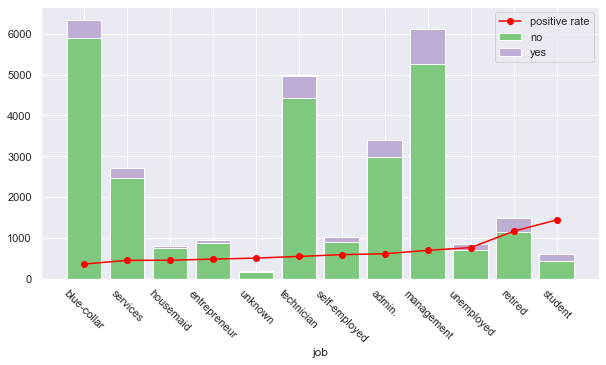

In [45]:
plt.figure(figsize = (10,5))
plt.bar(range(len(job)),height = data_info['no'], label = 'no')
plt.bar(range(len(job)),height = data_info['yes'], bottom = data_info['no'], label = 'yes')
plt.plot(data_info['value'],data_info['pct']*5000,'o-',color = 'r', label = 'positive rate')
plt.xlabel('job')
plt.xticks(rotation = -45)
plt.legend()
plt.show()

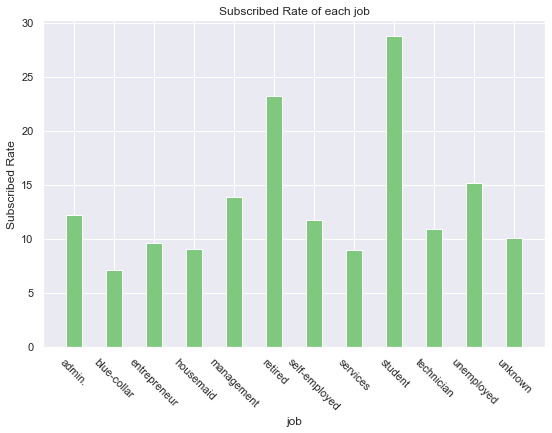

In [46]:
plotYesNo(category)

### Marital

In [47]:
category  = 'marital'
marital = train[category].sort_values().unique()
data_info = pd.DataFrame(columns = ['category', 'value', 'yes', 'no', 'pct'])

for value in marital:
    temp = [category, value]
    temp_array = pct(category, value)
    temp.append(temp_array[0])
    temp.append(temp_array[1])
    temp.append(temp_array[2])
    temp = pd.Series(temp, index=['category', 'value', 'yes', 'no', 'pct'])
    data_info = data_info.append(temp, ignore_index = True)
    
data_info.sort_values(by='pct', inplace=True)
data_info

,category,value,yes,no,pct
1,marital,married,1800.0,15774.0,0.102424
0,marital,divorced,413.0,3006.0,0.120796
2,marital,single,1225.0,7169.0,0.145938


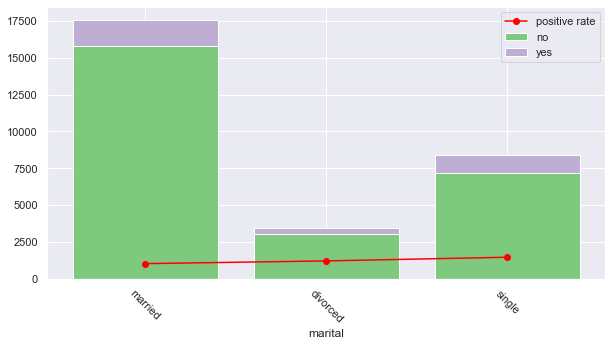

In [48]:
plt.figure(figsize = (10,5))
plt.bar(range(len(marital)),height = data_info['no'], label = 'no')
plt.bar(range(len(marital)),height = data_info['yes'], bottom = data_info['no'], label = 'yes')
plt.plot(data_info['value'],data_info['pct']*10000,'o-',color = 'r', label = 'positive rate')
plt.xlabel(category)
plt.xticks(rotation = -45)
plt.legend()
plt.show()

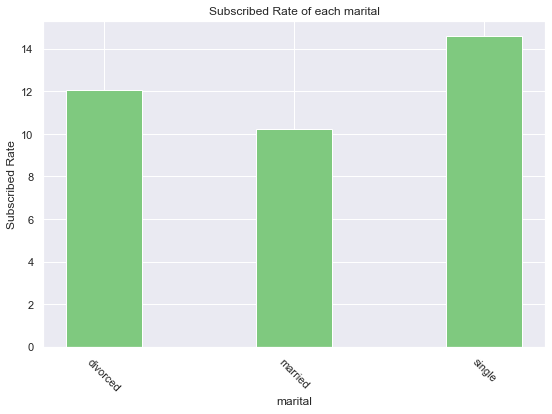

In [49]:
plotYesNo(category)

### Education

In [50]:
category = 'education'
education = train[category].sort_values().unique()
data_info = pd.DataFrame(columns = ['category', 'value', 'yes', 'no', 'pct'])

for value in education:
    temp = [category, value]
    temp_array = pct(category, value)
    temp.append(temp_array[0])
    temp.append(temp_array[1])
    temp.append(temp_array[2])
    temp = pd.Series(temp, index=['category', 'value', 'yes', 'no', 'pct'])
    data_info = data_info.append(temp, ignore_index = True)
    
data_info

,category,value,yes,no,pct
0,education,primary,387.0,4069.0,0.086849
1,education,secondary,1588.0,13515.0,0.105145
2,education,tertiary,1301.0,7338.0,0.150596
3,education,unknown,162.0,1027.0,0.136249


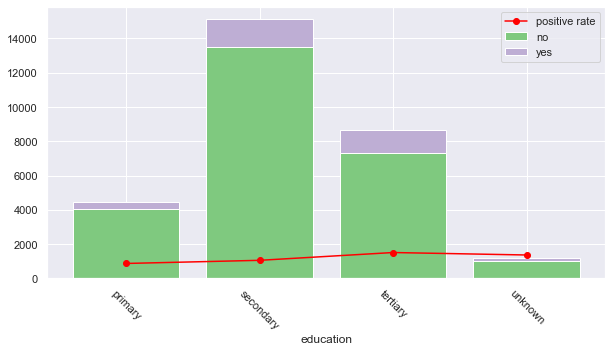

In [51]:
plt.figure(figsize = (10,5))
plt.bar(range(len(education)),height = data_info['no'], label = 'no')
plt.bar(range(len(education)),height = data_info['yes'], bottom = data_info['no'], label = 'yes')
plt.plot(data_info['value'],data_info['pct']*10000,'o-',color = 'r', label = 'positive rate')
plt.xlabel('education')
plt.xticks(rotation = -45)
plt.legend()
plt.show()

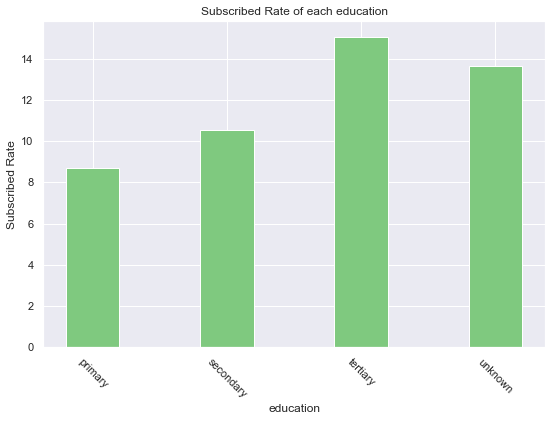

In [52]:
plotYesNo(category)

### Default

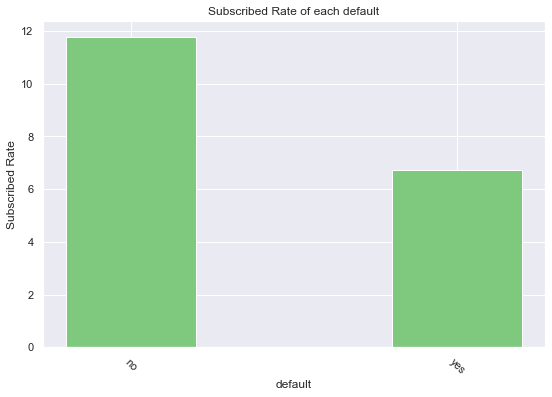

In [53]:
category = 'default'
plotYesNo(category, text=True)

### Housing

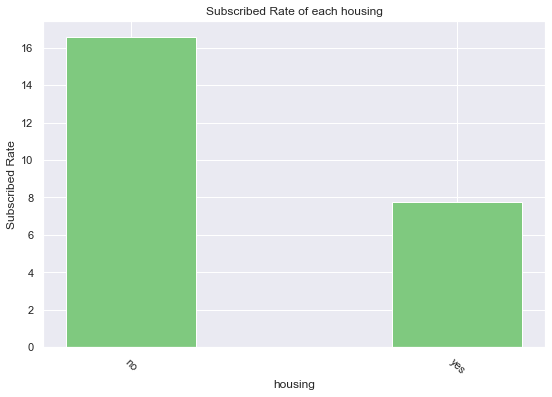

In [54]:
category = 'housing'
plotYesNo(category)

### Loan

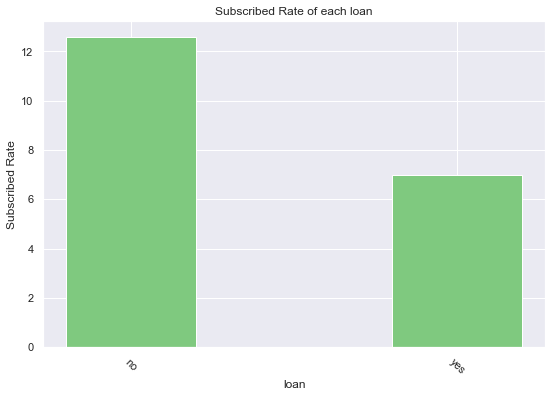

In [55]:
category = 'loan'
plotYesNo(category)

### Contact

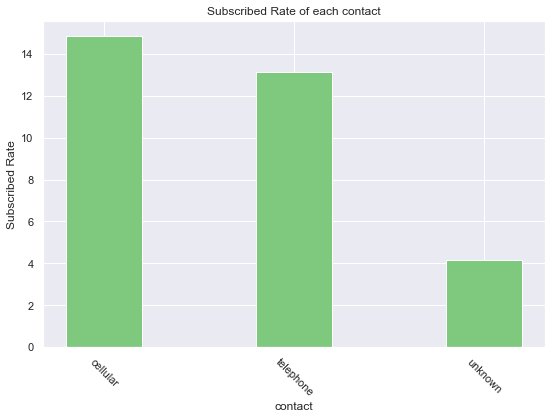

In [56]:
category = 'contact'
plotYesNo(category)

### Poutcome

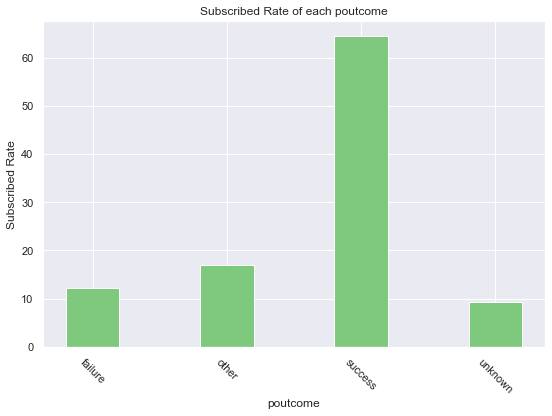

In [57]:
category = 'poutcome'
plotYesNo(category)

### -- Short Summary

In [58]:
cat_list = ['job', 'education', 'default', 'housing', 'loan', 'marital', 'contact', 'poutcome']
train.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,campaign,pdays,previous,poutcome,subscribed,date,date_diff
0,29,admin.,married,secondary,no,1489,yes,no,cellular,20,4,1,999,0,unknown,0,2021-04-20,104
1,33,admin.,single,tertiary,no,3379,no,no,cellular,20,11,3,999,0,unknown,0,2021-11-20,318
2,30,management,married,tertiary,no,3134,yes,no,cellular,17,7,1,999,0,unknown,0,2021-07-17,192
3,33,admin.,divorced,secondary,no,294,yes,no,cellular,8,5,1,999,0,unknown,1,2021-05-08,122
4,42,technician,married,tertiary,no,644,yes,no,unknown,7,5,1,999,0,unknown,0,2021-05-07,121


## Deeper Exploring

### Age Group

In [59]:
ages = train['age']
bins = [0, 30, 40, 50, 60, 100]
age_group = pd.cut(ages, bins)
train['age_group'] = age_group
age_y_cross = pd.crosstab(train['subscribed'], train['age_group'])
age_y_cross_rate = age_y_cross.apply(lambda x : x/x.sum() * 100).transpose().reset_index()
age_y_cross_rate

subscribed,age_group,0,1
0,"(0, 30]",84.181778,15.818222
1,"(30, 40]",89.614682,10.385318
2,"(40, 50]",91.084370,8.915630
3,"(50, 60]",89.823687,10.176313
4,"(60, 100]",56.905371,43.094629


In [67]:
pdays = train['pdays']
bins = [0, 100, 999]
pdays_group = pd.cut(pdays, bins)
train['pdays_group'] = pdays_group
age_pdays_cross = pd.crosstab(train['pdays_group'], train['age_group'])
age_pdays_cross_rate = age_pdays_cross.apply(lambda x : x / x.sum() * 100).transpose().reset_index(drop=True)
age_pdays_cross_rate

pdays_group,"(0, 100]","(100, 999]"
0,4.063797,95.936203
1,2.826824,97.173176
2,2.133187,97.866813
3,3.257953,96.742047
4,13.682864,86.317136


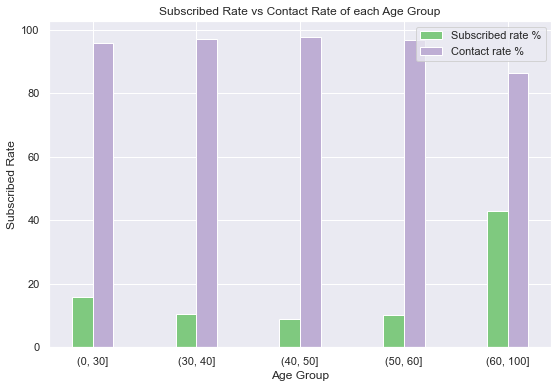

In [68]:
plt.bar(age_y_cross_rate.index - 0.1, age_y_cross_rate[1], width=0.2, label='Subscribed rate %')
plt.bar(age_pdays_cross_rate.index + 0.1, age_pdays_cross_rate.iloc[:, 1], width=0.2, label='Contact rate %')
plt.xticks(age_y_cross_rate.index, age_y_cross_rate['age_group'].astype(str))
plt.xlabel('Age Group')
plt.ylabel('Subscribed Rate')
plt.title('Subscribed Rate vs Contact Rate of each Age Group')
plt.legend()
plt.show()

### Balance Group

In [69]:
balance = train['balance']
bins = [-3000, 0, 1000, 2000, 3000, 4000, 10000]
balance_group = pd.cut(balance, bins)
train['balance_group'] = balance_group
balance_y_cross = pd.crosstab(train['subscribed'], train['balance_group'])
balance_y_cross_rate = balance_y_cross.apply(lambda x : x/x.sum() * 100).transpose().reset_index()
balance_y_cross_rate

subscribed,balance_group,0,1
0,"(-3000, 0]",93.036791,6.963209
1,"(0, 1000]",88.985795,11.014205
2,"(1000, 2000]",86.375126,13.624874
3,"(2000, 3000]",83.288264,16.711736
4,"(3000, 4000]",82.905226,17.094774
5,"(4000, 10000]",84.427481,15.572519


In [70]:
balance_pdays_cross = pd.crosstab(train['pdays_group'], train['balance_group'])
balance_pdays_cross_rate = balance_pdays_cross.apply(lambda x : x/x.sum() * 100).transpose().reset_index(drop=True)
balance_pdays_cross_rate

pdays_group,"(0, 100]","(100, 999]"
0,1.642070,98.357930
1,2.926990,97.073010
2,4.246714,95.753286
3,5.083829,94.916171
4,4.074402,95.925598
5,4.427481,95.572519


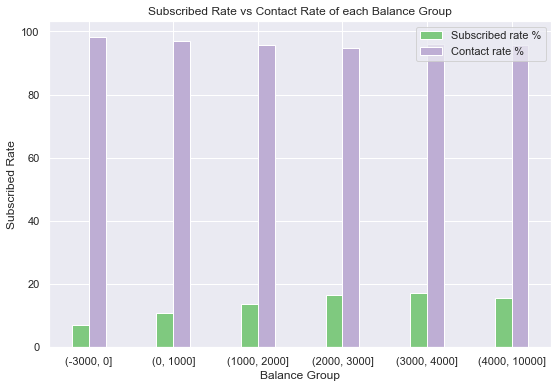

In [71]:
plt.bar(balance_y_cross_rate.index - 0.1, balance_y_cross_rate[1], width=0.2, label='Subscribed rate %')
plt.bar(balance_pdays_cross_rate.index + 0.1, balance_pdays_cross_rate.iloc[:, 1], width=0.2, label='Contact rate %')
plt.xticks(balance_y_cross_rate.index, balance_y_cross_rate['balance_group'].astype(str))
plt.xlabel('Balance Group')
plt.ylabel('Subscribed Rate')
plt.title('Subscribed Rate vs Contact Rate of each Balance Group')
plt.legend()
plt.show()

# Model

## Data Transformation

In [72]:
num_var = ['age', 'balance', 'campaign', 'pdays', 'previous', 'day', 'month', 'date_diff']
cat_var = ['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'poutcome']

yj = PowerTransformer(method='yeo-johnson')
train['age']  = yj.fit_transform(train[['age']])
train['balance']  = yj.fit_transform(train[['balance']])
train['date_diff']  = yj.fit_transform(train[['date_diff']])
scaler = StandardScaler().fit(train[num_var], train['subscribed'])
encoder = CatBoostEncoder().fit(train[cat_var], train['subscribed'])

train[num_var] = scaler.transform(train[num_var])
train[cat_var] = encoder.transform(train[cat_var])

## Preparation

In [73]:
train.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,...,campaign,pdays,previous,poutcome,subscribed,date,date_diff,age_group,pdays_group,balance_group
0,-1.236728,0.121756,0.102425,0.105145,0.117881,0.198091,0.077685,0.125992,0.148487,0.496847,...,-0.568197,0.465589,-0.305997,0.092805,0,2021-04-20,-0.789413,"(0, 30]","(100, 999]","(1000, 2000]"
1,-0.706859,0.121756,0.145934,0.150592,0.117881,0.814296,0.165924,0.125992,0.148487,0.496847,...,0.065705,0.465589,-0.305997,0.092805,0,2021-11-20,1.924806,"(30, 40]","(100, 999]","(3000, 4000]"
2,-1.096622,0.138594,0.102425,0.150592,0.117881,0.738529,0.077685,0.125992,0.148487,0.136638,...,-0.568197,0.465589,-0.305997,0.092805,0,2021-07-17,0.400324,"(0, 30]","(100, 999]","(3000, 4000]"
3,-0.706859,0.121756,0.120794,0.105145,0.117881,-0.266936,0.077685,0.125992,0.148487,-0.943990,...,-0.568197,0.465589,-0.305997,0.092805,1,2021-05-08,-0.533336,"(30, 40]","(100, 999]","(0, 1000]"
4,0.252024,0.108623,0.102425,0.150592,0.117881,-0.117463,0.077685,0.125992,0.041735,-1.064059,...,-0.568197,0.465589,-0.305997,0.092805,0,2021-05-07,-0.547353,"(40, 50]","(100, 999]","(0, 1000]"


In [74]:
num_list = ['age', 'balance', 'month', 'day', 'pdays', 'previous', 'campaign', 'date_diff']
cat_list = ['job', 'education', 'default', 'housing', 'loan', 'marital', 'contact', 'poutcome']
X = train[np.append(num_list, cat_list)]
y = train['subscribed']
X.head()

,age,balance,month,day,pdays,previous,campaign,date_diff,job,education,default,housing,loan,marital,contact,poutcome
0,-1.236728,0.198091,-0.889361,0.496847,0.465589,-0.305997,-0.568197,-0.789413,0.121756,0.105145,0.117881,0.077685,0.125992,0.102425,0.148487,0.092805
1,-0.706859,0.814296,2.024451,0.496847,0.465589,-0.305997,0.065705,1.924806,0.121756,0.150592,0.117881,0.165924,0.125992,0.145934,0.148487,0.092805
2,-1.096622,0.738529,0.359416,0.136638,0.465589,-0.305997,-0.568197,0.400324,0.138594,0.150592,0.117881,0.077685,0.125992,0.102425,0.148487,0.092805
3,-0.706859,-0.266936,-0.473102,-0.943990,0.465589,-0.305997,-0.568197,-0.533336,0.121756,0.105145,0.117881,0.077685,0.125992,0.120794,0.148487,0.092805
4,0.252024,-0.117463,-0.473102,-1.064059,0.465589,-0.305997,-0.568197,-0.547353,0.108623,0.150592,0.117881,0.077685,0.125992,0.102425,0.041735,0.092805


## Train test split

In [75]:
ss = StratifiedShuffleSplit(n_splits=2, test_size=0.2, random_state=42)
for train_full_index, test_index in ss.split(X, y):
    X_train_full, X_test = X.iloc[train_full_index], X.iloc[test_index]
    y_train_full, y_test = y.iloc[train_full_index], y.iloc[test_index]
    
ss = StratifiedShuffleSplit(n_splits=2, test_size=0.25, random_state=42)
for train_index, valid_index in ss.split(X_train_full, y_train_full):
    X_train, X_valid = X_train_full.iloc[train_index], X_train_full.iloc[valid_index]
    y_train, y_valid = y_train_full.iloc[train_index], y_train_full.iloc[valid_index]
    
# X_train_full, X_test, y_train_full, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
# X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.25, random_state=42, stratify=y_train)

## Feature Engineering

### Polynomial Exploring

In [76]:
def polyExplore(target, times=10):
    target_train = X_train[target]
    X_train_temp = pd.DataFrame()
    target_valid = X_valid[target]
    X_valid_temp = pd.DataFrame()
    columns = ['Error Rate', 'Sensitivity', 'Specificity', 'Precision', 'AUC', 'Cross-entropy', 'cross-AUC']
    rows = range(1, times)
    results = pd.DataFrame(0.0, columns=columns, index=rows)
    def polyExploreThread(i):
        temp_train = X_train_temp.iloc[:, :i]
        temp_valid = X_valid_temp.iloc[:, :i]
        logit = LogisticRegressionCV()
        logit.fit(temp_train, y_train)
        y_prob = logit.predict_proba(temp_valid)[:, 1]
        y_pred = logit.predict(temp_valid)

        tn, fp, fn, tp = confusion_matrix(y_valid, y_pred).ravel() 

        results.iloc[i-1, 0] =  1 - accuracy_score(y_valid, y_pred)
        results.iloc[i-1, 1] =  tp / (tp + fn)
        results.iloc[i-1, 2] =  tn / (tn + fp)
        results.iloc[i-1, 3] =  precision_score(y_valid, y_pred)
        results.iloc[i-1, 4] =  roc_auc_score(y_valid, y_prob)
        results.iloc[i-1, 5] =  log_loss(y_valid, y_prob)
        results.iloc[i-1, 6] =  cross_val_score(logit, temp_train, y_train, scoring='roc_auc').mean()

    thread_list = []

    for i in range(1, times):
        X_train_temp[target+str(i)] = target_train ** i
        X_valid_temp[target+str(i)] = target_valid ** i
        
    for i in range(1, times):
        thread = threading.Thread(target=polyExploreThread, args=(i,))
        thread_list.append(thread)
        thread.start()
  
    for thread in thread_list:
        thread.join()
        
    return results

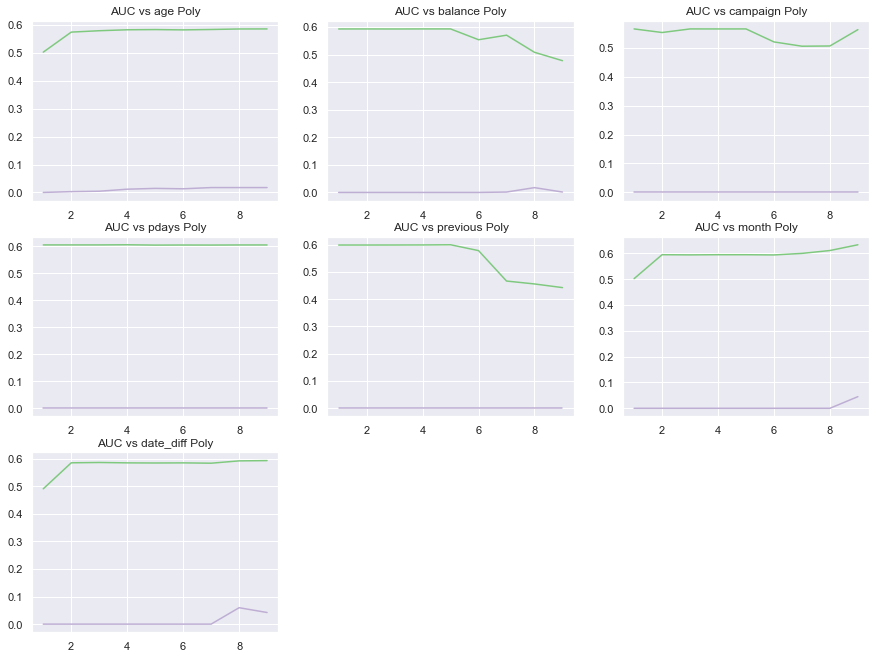

Wall time: 6min 29s


In [77]:
%%time
x_input = ['age', 'balance', 'campaign', 'pdays', 'previous', 'month', 'date_diff']
x_count = len(x_input)
rows = int(np.ceil(x_count/3))
fig, axes = plt.subplots(rows, 3, figsize=(15, rows*(15/4)))
thread_list = []
def polyThread(i, ax):
    global x_count, x_input
    if i < x_count:
        poly = polyExplore(x_input[i])
        sns.lineplot(x=poly.index, y=poly['cross-AUC'], ax=ax)
        sns.lineplot(x=poly.index, y=poly['Sensitivity'], ax=ax)
        ax.set_xlabel('')
        ax.set_ylabel('')
        ax.set_title('AUC vs {} Poly'.format(x_input[i]))
    else:
        fig.delaxes(ax)
for i, ax in enumerate(fig.axes):
    thread = threading.Thread(target=polyThread, args=(i, ax, ))
    thread_list.append(thread)
    thread.start()
for thread in thread_list:
    thread.join()
plt.show()

### Model Transformation

In [78]:
class ModelTrans:
    def __init__(self, age=1, balance=1, campaign=1, pdays=1, previous=1, month=1, date_diff=1): 
        self.age = age
        self.balance = balance
        self.campaign = campaign
        self.pdays = pdays
        self.previous = previous
        self.date_diff = date_diff
        self.month = month

    def xTrans(self, x):
        for i in range(2, self.age + 1):
            x['age'+str(i)] = x['age'] ** i
        for i in range(2, self.balance + 1):
            x['balance'+str(i)] = x['balance'] ** i
        for i in range(2, self.campaign + 1):
            x['campaign'+str(i)] = x['campaign'] ** i
        for i in range(2, self.pdays + 1):
            x['pdays'+str(i)] = x['pdays'] ** i
        for i in range(2, self.previous + 1):
            x['previous'+str(i)] = x['previous'] ** i
        for i in range(2, self.month + 1):
            x['month'+str(i)] = x['month'] ** i
        for i in range(2, self.date_diff + 1):
            x['date_diff'+str(i)] = x['date_diff'] ** i
        return x

In [80]:
modelTrans = ModelTrans(age=2, month=2, date_diff=2)
X_train = modelTrans.xTrans(X_train)
X_valid = modelTrans.xTrans(X_valid)
X = modelTrans.xTrans(X)

## Model Fitting

In [87]:
def hypmExplore(model, params):
    count = len(params)
    rows = int(np.ceil(count / 3))
    fig, axes = plt.subplots(rows, 3, figsize=(15, rows*(15/4)), constrained_layout=True)

    for i, ax in enumerate(fig.axes):
        if i < count:
            param_key = list(params.keys())[i]
            param_val = params[param_key]
            train_AUC = []
            valid_AUC = []
            indexs = []

            for j in param_val:
                param_input = {param_key: j}
                model.set_params(**param_input)
                model.fit(X_train, y_train)
                y_prob = model.predict_proba(X_train)[:, 1]
                train_AUC.append(roc_auc_score(y_train, y_prob))
                valid_AUC.append(np.mean(cross_validate(model, X_valid, y_valid, cv=5)['test_score']))
                indexs.append(j)

            ax.plot(indexs, train_AUC, label="Training AUC", marker='o',)
            ax.plot(indexs, valid_AUC, label="5 fold CV Validation AUC", marker='o')
            ax.set_xlabel(param_key, fontsize=18)
            ax.set_ylabel('AUC', fontsize=18)
            ax.legend()

        else:
            fig.delaxes(ax)

    plt.tight_layout()
    plt.show()

### Logistic Regression CV

In [88]:
logit = LogisticRegressionCV()
logit.fit(X_train, y_train)

LogisticRegressionCV()

### KNN

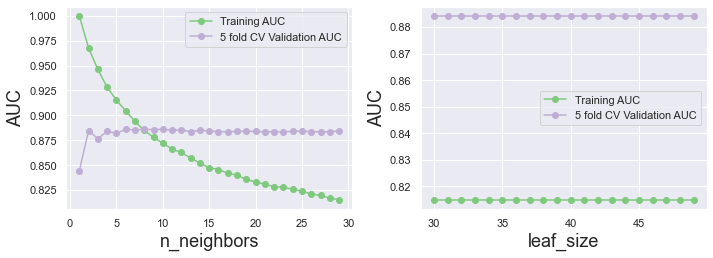

Wall time: 3min 38s


In [89]:
%%time
knn = KNeighborsClassifier()
params = {
    'n_neighbors':range(1, 30),
    'leaf_size':range(30, 50)
}
hypmExplore(knn, params)

In [117]:
params = {
    'n_neighbors': list(range(1, 15))
}
knn = KNeighborsClassifier()
grid_search = GridSearchCV(
    estimator=knn, 
    param_grid=params, 
    cv=5, 
    n_jobs=-1, 
    verbose=1, 
    scoring = "roc_auc")
grid_search.fit(X, y)

Fitting 5 folds for each of 14 candidates, totalling 70 fits


GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                         13, 14]},
             scoring='roc_auc', verbose=1)

In [118]:
knn = grid_search.best_estimator_
knn

KNeighborsClassifier(n_neighbors=14)

In [94]:
y_prob = grid_search.best_estimator_.predict_proba(X_train)[:, 1]
train_AUC = roc_auc_score(y_train, y_prob)
valid_AUC = cross_validate(grid_search.best_estimator_, X_valid, y_valid, cv=5)['test_score'].mean()
# y_prob = grid_search.best_estimator_.predict_proba(X_test)[:, 1]
# test_AUC = roc_auc_score(y_test, y_prob)
print('train AUC: {}, \nvalidation AUC: {}'.format(train_AUC, valid_AUC))

train AUC: 0.8720916131991256, 
validation AUC: 0.8858454190186713


### LGBoost

In [95]:
lgb = LGBMClassifier(
    learning_rate = 0.01,
    max_depth = 10,
    num_leaves = 20,
    subsample = 0.2, 
    objective = 'binary', 
    metric = 'auc',
    is_unbalance = True,
    boosting = 'gbdt',
    num_boost_round = 300,
    early_stopping_rounds = 30
)

eval_set = [(X_valid, y_valid)]
lgb.fit(X_train, y_train, eval_set=eval_set, verbose=True)
y_prob = lgb.predict_proba(X_valid)[:, 1]
print('Validation AUC:{}'.format(roc_auc_score(y_valid, y_prob)))

[LightGBM] [Warning] boosting is set=gbdt, boosting_type=gbdt will be ignored. Current value: boosting=gbdt
[LightGBM] [Warning] num_iterations is set=300, num_boost_round=300 will be ignored. Current value: num_iterations=300
[LightGBM] [Warning] early_stopping_round is set=30, early_stopping_rounds=30 will be ignored. Current value: early_stopping_round=30
[1]	valid_0's auc: 0.773759
[2]	valid_0's auc: 0.777532
[3]	valid_0's auc: 0.772868
[4]	valid_0's auc: 0.772389
[5]	valid_0's auc: 0.777018
[6]	valid_0's auc: 0.778749
[7]	valid_0's auc: 0.778161
[8]	valid_0's auc: 0.776983
[9]	valid_0's auc: 0.77829
[10]	valid_0's auc: 0.778195
[11]	valid_0's auc: 0.780556
[12]	valid_0's auc: 0.780198
[13]	valid_0's auc: 0.779402
[14]	valid_0's auc: 0.77908
[15]	valid_0's auc: 0.779787
[16]	valid_0's auc: 0.780278
[17]	valid_0's auc: 0.780104
[18]	valid_0's auc: 0.780384
[19]	valid_0's auc: 0.780492
[20]	valid_0's auc: 0.780242
[21]	valid_0's auc: 0.780132
[22]	valid_0's auc: 0.780249
[23]	valid_0

In [96]:
# lgb.fit(X_train_full, y_train_full, eval_set=eval_set, verbose=True)
# y_prob = lgb.predict_proba(X_test)[:, 1]
# print('Test AUC:{}'.format(roc_auc_score(y_test, y_prob)))

### Random Forest

In [97]:
%%time
def objective(trial):
    criterion = trial.suggest_categorical('criterion', ['entropy', 'gini'])
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 30)
    max_features = trial.suggest_int('max_features', 1, len(X_train.columns))
    
    model = RandomForestClassifier(n_estimators=100,  
                                  criterion = criterion,  
                                  max_features = max_features, 
                                  min_samples_leaf= min_samples_leaf,
                                  random_state = 42)
    
    scores = cross_val_score(model, X_train, y_train, cv = 5, scoring = 'roc_auc')
    loss = 1 - np.mean(scores)
    auc = scores.mean()
    return auc

sampler = TPESampler(seed=42) 
study = optuna.create_study(direction='maximize', sampler=sampler)
study.optimize(objective, n_trials=100, timeout=120) 

[I 2021-10-25 16:17:17,155] A new study created in memory with name: no-name-cb11a27b-4829-4d0c-847e-861337204795
[I 2021-10-25 16:17:27,334] Trial 0 finished with value: 0.788311869328745 and parameters: {'criterion': 'gini', 'min_samples_leaf': 22, 'max_features': 12}. Best is trial 0 with value: 0.788311869328745.
[I 2021-10-25 16:17:45,797] Trial 1 finished with value: 0.7725773094646845 and parameters: {'criterion': 'entropy', 'min_samples_leaf': 2, 'max_features': 17}. Best is trial 0 with value: 0.788311869328745.
[I 2021-10-25 16:18:06,107] Trial 2 finished with value: 0.7674182089976791 and parameters: {'criterion': 'gini', 'min_samples_leaf': 1, 'max_features': 19}. Best is trial 0 with value: 0.788311869328745.
[I 2021-10-25 16:18:11,068] Trial 3 finished with value: 0.7878288900144172 and parameters: {'criterion': 'entropy', 'min_samples_leaf': 6, 'max_features': 4}. Best is trial 0 with value: 0.788311869328745.
[I 2021-10-25 16:18:16,679] Trial 4 finished with value: 0.78

Wall time: 2min 10s


In [124]:
params = study.best_params
params

{'criterion': 'entropy', 'min_samples_leaf': 19, 'max_features': 4}

In [125]:
rf = RandomForestClassifier(n_estimators=1000, **params)
rf.fit(X_train, y_train)

RandomForestClassifier(criterion='entropy', max_features=4, min_samples_leaf=19,
                       n_estimators=1000)

In [100]:
# rf.fit(X_train_full, y_train_full)
# y_prob = rf.predict_proba(X_test)[:, 1]
# print('Test AUC:{}'.format(roc_auc_score(y_test, y_prob)))

### Calibrated random forest

In [126]:
calibrated_rf = CalibratedClassifierCV(rf, cv = 5, method='isotonic')
calibrated_rf.fit(X_train, y_train)

CalibratedClassifierCV(base_estimator=RandomForestClassifier(criterion='entropy',
                                                             max_features=4,
                                                             min_samples_leaf=19,
                                                             n_estimators=1000),
                       cv=5, method='isotonic')

In [102]:
# calibrated_rf.fit(X_train_full, y_train_full)
# y_prob = calibrated_rf.predict_proba(X_test)[:, 1]
# print('Test AUC:{}'.format(roc_auc_score(y_test, y_prob)))

### Decision Tree

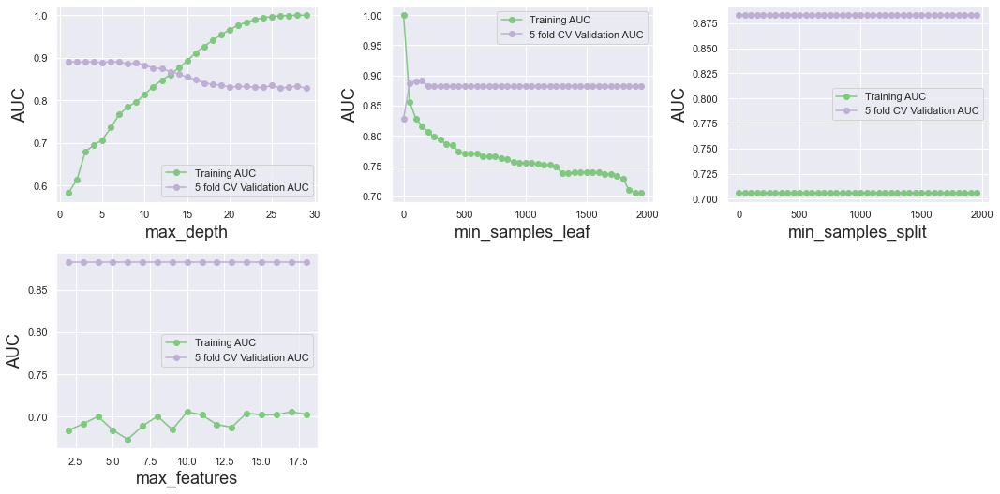

Wall time: 9.57 s


In [103]:
%%time
deTree = DecisionTreeClassifier()
params = {
    'max_depth': range(1, 30),
    'min_samples_leaf': range(1, 2000, 50),
    'min_samples_split': range(2, 2000, 50),
    'max_features': range(2, len(X_train.columns))
}
hypmExplore(deTree, params)

In [119]:
params = {
    'max_depth': [2, 3, 4, 5, 6, 7, 8, 9, 10, 20, 30, 40],
    'min_samples_split': [5, 20, 50, 100, 500],
    'min_samples_leaf': [5, 20, 50, 100, 500],
    'criterion': ["gini", "entropy"],
    'splitter': ['best','random']    
}
deTree = DecisionTreeClassifier(random_state=42)
grid_search = GridSearchCV(
    estimator=deTree, 
    param_grid=params, 
    cv=5, 
    n_jobs=-1, 
    verbose=1, 
    scoring = "roc_auc")

grid_search.fit(X, y)

Fitting 5 folds for each of 1200 candidates, totalling 6000 fits


GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=42), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [2, 3, 4, 5, 6, 7, 8, 9, 10, 20, 30, 40],
                         'min_samples_leaf': [5, 20, 50, 100, 500],
                         'min_samples_split': [5, 20, 50, 100, 500],
                         'splitter': ['best', 'random']},
             scoring='roc_auc', verbose=1)

In [120]:
deTree = grid_search.best_estimator_
deTree

DecisionTreeClassifier(max_depth=20, min_samples_leaf=5, min_samples_split=500,
                       random_state=42)

In [106]:
y_prob = grid_search.best_estimator_.predict_proba(X_train)[:, 1]
train_AUC = roc_auc_score(y_train, y_prob)
valid_AUC = cross_validate(grid_search.best_estimator_, X_valid, y_valid, cv=5)['test_score'].mean()
# y_prob = grid_search.best_estimator_.predict_proba(X_test)[:, 1]
# test_AUC = roc_auc_score(y_test, y_prob)
print('train AUC: {}, \nvalidation AUC: {}'.format(train_AUC, valid_AUC))

train AUC: 0.8267135991533325, 
validation AUC: 0.8890783036618902


### Bagging

In [107]:
bag = BaggingClassifier(DecisionTreeClassifier(criterion='entropy'), n_estimators=1000, random_state=42)
bag.fit(X_train, y_train)

BaggingClassifier(base_estimator=DecisionTreeClassifier(criterion='entropy'),
                  n_estimators=1000, random_state=42)

### SVM

In [108]:
# sv = svm.SVC(C=2, kernel='rbf', gamma=10, decision_function_shape='ovo', probability=True)
# sv.fit(X_train, y_train)

### Gaussian NB

In [109]:
nb = GaussianNB()
nb.fit(X_train, y_train)

GaussianNB()

### -- Model Performance Summary

In [128]:
models = []
models.append({'name': 'logitCV', 'model': logit})
models.append({'name': 'KNN', 'model': knn})
models.append({'name': 'Decision Tree', 'model': deTree})
models.append({'name': 'Random Forest', 'model': rf})
models.append({'name': 'calibrated RF', 'model': calibrated_rf})
models.append({'name': 'Bagging', 'model': bag})
# models.append({'name' : 'svm', 'model' : svm.SVC(C=2, kernel='rbf', gamma=10, decision_function_shape='ovo', probability=True)})
models.append({'name': 'NB', 'model': nb})
models.append({'name': 'LGBM','model': lgb})

In [111]:
results = []
names = []
seed = 42
msgs = []
thread_list = []

def trainModelThread(model):
    global count
    kfold = KFold(n_splits=10, random_state=seed, shuffle=True)
#     model['model'].fit(X_train, y_train)
    score = cross_val_score(model['model'], X_train, y_train, cv=kfold, scoring='roc_auc')    
    results.append(score)
    name = model['name']
    names.append(name)
    msgs.append("{model} -> mean:{mean}, std:{std}\n".format(model=name, mean=score.mean(), std=score.std()))
    print('{} finished.'.format(name))
    
for model in models:
    thread = threading.Thread(target=trainModelThread, args=(model,))
    thread_list.append(thread)
    thread.start()
    
for thread in thread_list:
    thread.join()

for msg in msgs:
    print(msg)

LGBM finished.
NB finished.
Decision Tree finished.
KNN finished.
logitCV finished.
Random Forest finished.
calibrated RF finished.
Bagging finished.
LGBM -> mean:nan, std:nan

NB -> mean:0.7209262001242919, std:0.0227845948617729

Decision Tree -> mean:0.6036750891725263, std:0.012421544572356993

KNN -> mean:0.6790502250081445, std:0.017471800060576803

logitCV -> mean:0.7452821596631711, std:0.0168146856958245

Random Forest -> mean:0.7896127972890192, std:0.015386167196460675

calibrated RF -> mean:0.7895015714318727, std:0.015896299873635302

Bagging -> mean:0.771983358166409, std:0.01844360358694396



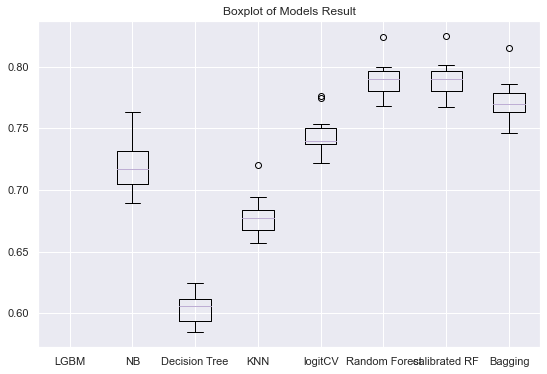

In [112]:
plt.boxplot(results)
index = list(range(1, len(models) + 1))
plt.xticks(index, names)
plt.title('Boxplot of Models Result')
plt.show()

## Model Validation

In [129]:
columns = ['Error Rate', 'Sensitivity', 'Specificity', 'Precision', 'AUC', 'Cross-entropy']
rows = []
for model in models:
    rows.append(model['name'])
results_valid = pd.DataFrame(0.0, columns=columns, index=rows) 
y_prob = np.zeros((len(y_valid), len(models)))

for i, model in enumerate(models):
    y_prob[:, i] = model['model'].predict_proba(X_valid)[:, 1]
    y_pred = model['model'].predict(X_valid)

    tn, fp, fn, tp = confusion_matrix(y_valid, y_pred).ravel() 

    results_valid.iloc[i,0] = 1 - accuracy_score(y_valid, y_pred)
    results_valid.iloc[i,1] = tp / (tp+fn)
    results_valid.iloc[i,2] = tn / (tn+fp)
    results_valid.iloc[i,3] = precision_score(y_valid, y_pred)
    results_valid.iloc[i,4] = roc_auc_score(y_valid, y_prob[:,i])
    results_valid.iloc[i,5] = log_loss(y_valid, y_prob[:,i])

results_valid.round(3)

,Error Rate,Sensitivity,Specificity,Precision,AUC,Cross-entropy
logitCV,0.108,0.189,0.985,0.625,0.755,0.308
KNN,0.104,0.179,0.991,0.724,0.855,0.256
Decision Tree,0.107,0.206,0.984,0.634,0.826,0.276
Random Forest,0.106,0.195,0.987,0.657,0.791,0.287
calibrated RF,0.105,0.227,0.984,0.650,0.791,0.287
Bagging,0.110,0.253,0.975,0.572,0.775,0.310
NB,0.166,0.395,0.893,0.328,0.732,1.144
LGBM,0.152,0.600,0.881,0.401,0.795,0.477


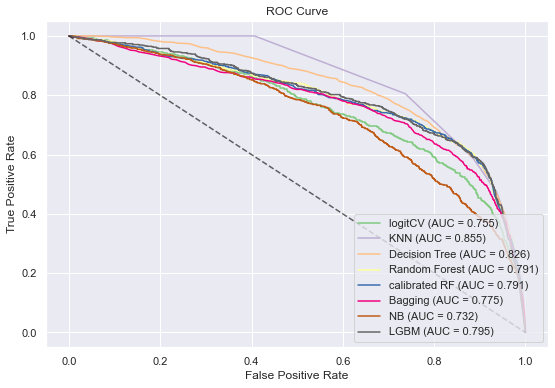

In [130]:
fig, ax = plt.subplots(figsize=(9,6))

for i in range(y_prob.shape[1]):
    fpr, tpr, thersholds = roc_curve(y_valid, y_prob[:, i])
    auc = roc_auc_score(y_valid, y_prob[:, i])
    ax.plot(1 - fpr, tpr, label=rows[i] + ' (AUC = {:.3f})'.format(auc))

ax.plot([0,1],[1,0], linestyle='--', color='black', alpha=0.6)
 
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc="lower right")
plt.show()


## Model Test

In [ ]:
test = test_raw.copy()
test.head()

In [ ]:
test['month'] = test['month'].apply(monthFormat)
test['date'] = test.apply(dateFormat, axis=1)
start_date = test.sort_values('date').iloc[0, :]['date']
test['date_diff'] = test['date'] - start_date
test['date_diff'] = test['date_diff'].astype('str').apply(lambda x:x[:-5]).astype('int32')

yj = PowerTransformer(method='yeo-johnson')
test['age']  = yj.fit_transform(test[['age']])
test['balance']  = yj.fit_transform(test[['balance']])
test['date_diff']  = yj.fit_transform(test[['date_diff']])

test[num_var] = scaler.transform(test[num_var])
test[cat_var] = encoder.transform(test[cat_var])

X_test = test[np.append(num_list, cat_list)]
X_test = modelTrans.xTrans(X_test)
X_test.head()

In [ ]:
grid_search.best_estimator_.fit(X, y)

In [ ]:
# Probability
method = grid_search.best_estimator_
test_prob = method.predict_proba(X_test)[:, 1]
y_pred = method.predict(X_test)

pd.DataFrame(test_prob)

In [ ]:
y_prob_final = test_prob
test_pred = test.copy()
test_pred['subscribed'] = y_prob_final
test_pred

# Evaluation

In [ ]:
# https://scikit-learn.org/stable/auto_examples/model_selection/plot_roc.html#sphx-glr-auto-examples-model-selection-plot-roc-py

# Export

In [ ]:
submission = test_pred[['id', 'subscribed']]
submission.to_csv("submission.csv", index = False)
submission

# Extra test (Delete when update)

In [ ]:
data_full = pd.read_excel('Data/bank-full.xlsx')
test_full = pd.merge(test_raw, data_full, on=['age', 'job', 'marital', 'education', 'default', 'balance', 'housing', 'loan', 'day', 'month', 'campaign', 'pdays', 'previous', 'poutcome', 'contact'])
test_full['y'] = test_full['y'].apply(lambda x : 0 if x == 'no' else 1)
test_full

In [ ]:
test_full['month'] = test_full['month'].apply(monthFormat)
test_full['date'] = test_full.apply(dateFormat, axis=1)
start_date = test_full.sort_values('date').iloc[0, :]['date']
test_full['date_diff'] = test_full['date'] - start_date
test_full['date_diff'] = test_full['date_diff'].astype('str').apply(lambda x:x[:-5]).astype('int32')

yj = PowerTransformer(method='yeo-johnson')
test_full['age']  = yj.fit_transform(test_full[['age']])
test_full['balance']  = yj.fit_transform(test_full[['balance']])
test_full['date_diff']  = yj.fit_transform(test_full[['date_diff']])

test_full[num_var] = scaler.transform(test_full[num_var])
test_full[cat_var] = encoder.transform(test_full[cat_var])



X_test = test_full[np.append(num_list, cat_list)]
X_test = modelTrans.xTrans(X_test)
y_test = test_full['y']
X_test.head()

In [ ]:
# Probability
method = grid_search.best_estimator_
y_pred_prob = method.predict_proba(X_test)[:, 1]
y_pred = method.predict(X_test)
roc_auc_score(y_test, y_pred_prob)